### Airbnb Data Preparation
* EDA
* Splitting
* Preprocessing

### Import Data and Library

In [ ]:
### Import library
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import statsmodels
import statsmodels.api as sm
import scipy.stats as stats
import verstack
verstack.__version__
from verstack.stratified_continuous_split import scsplit
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler, OneHotEncoder, OrdinalEncoder, MinMaxScaler

### Import Dataset
Airbnb = pd.read_csv("../Data/AB_NYC_2019.csv")


## 1. EDA
---
### Overall
#### a. Shape

In [ ]:
### Inspect shape
print("Number of Observations: ", str(Airbnb.shape[0]))
print("Number of Features: ", str(Airbnb.shape[1]))
### Examing head
#Airbnb.head(5)

#### b. Data Type

In [ ]:
Airbnb.dtypes

From the data table, we know variable last_view is date, Hence we will convert it to type date.

In [4]:
Airbnb['last_review'] = pd.to_datetime(Airbnb['last_review'],infer_datetime_format=True)
Airbnb.dtypes

id                                         int64
name                                      object
host_id                                    int64
host_name                                 object
neighbourhood_group                       object
neighbourhood                             object
latitude                                 float64
longitude                                float64
room_type                                 object
price                                      int64
minimum_nights                             int64
number_of_reviews                          int64
last_review                       datetime64[ns]
reviews_per_month                        float64
calculated_host_listings_count             int64
availability_365                           int64
dtype: object

#### c. Missing Data

,Total number of missing values,Percent
last_review,10052,0.205583
reviews_per_month,10052,0.205583
host_name,21,0.000429
name,16,0.000327


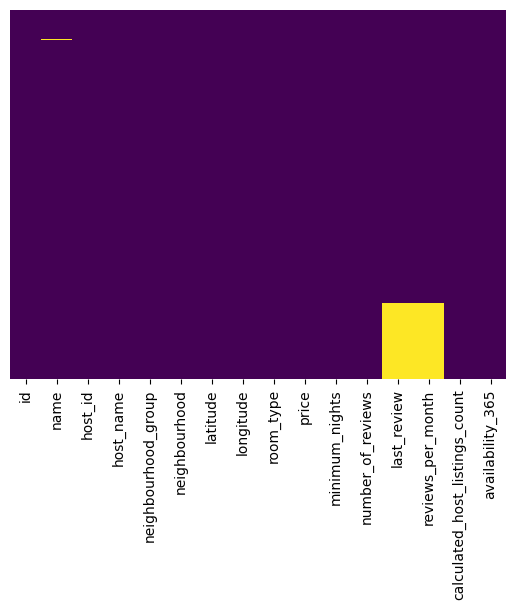

In [5]:
total = Airbnb.isnull().sum().sort_values(ascending = False)
percent = Airbnb.isnull().sum()/Airbnb.shape[0]
missing_data = pd.concat([total, percent], axis=1, 
                         keys=['Total number of missing values','Percent'], 
                         sort=False).sort_values('Total number of missing values', ascending=False)
sns.heatmap(Airbnb.sort_values("reviews_per_month").isnull(),yticklabels = False, 
            cbar = False, cmap = "viridis")
missing_data[missing_data["Total number of missing values"]>0]
#plt.savefig('figures/missing_data.png')

**4** out of **16** variables contain missing values and they are:
- **Categorical**
    - `name` (Airbnb name)
    - `host_name` (Airbnb owner's name)
- **Continuous**
    - `last_review` (The date of the latest review recieved)
    - `reviews_per_month` (number of review a Airbnb recieved in a month)
        - Potential explaination: `Nan` indicates the Airbnb have not received any reviews.


### 0. Price (target)

* Summary statistics

In [6]:
value = Airbnb['price'].describe()
Summary = pd.concat([value], axis=1, 
                         keys=['value'], 
                         sort=False)
print("the mode is:", str(Airbnb['price'].mode()[0]))
Summary

the mode is: 100


,value
count,48895.000000
mean,152.720687
std,240.154170
min,0.000000
25%,69.000000
50%,106.000000
75%,175.000000
max,10000.000000


* Plot

In [ ]:
plt.figure(figsize = (6,5))
Airbnb['price'].plot.hist(log=True, bins = np.logspace(np.log10(1),np.log10(np.max(Airbnb['price'])),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('Price per night')
plt.ylabel('Count')
plt.title('New York Airbnb Price Distribution')
#plt.savefig('figures/price_distribution.png')
plt.show()

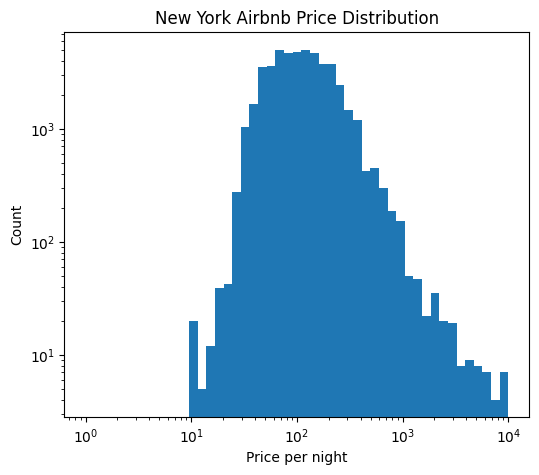

In [7]:
plt.figure(figsize = (6,5))
Airbnb['price'].plot.hist(log=True, bins = np.logspace(np.log10(1),np.log10(np.max(Airbnb['price'])),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('Price per night')
plt.ylabel('Count')
plt.title('New York Airbnb Price Distribution')
#plt.savefig('figures/price_distribution.png')
plt.show()

* Boxplot

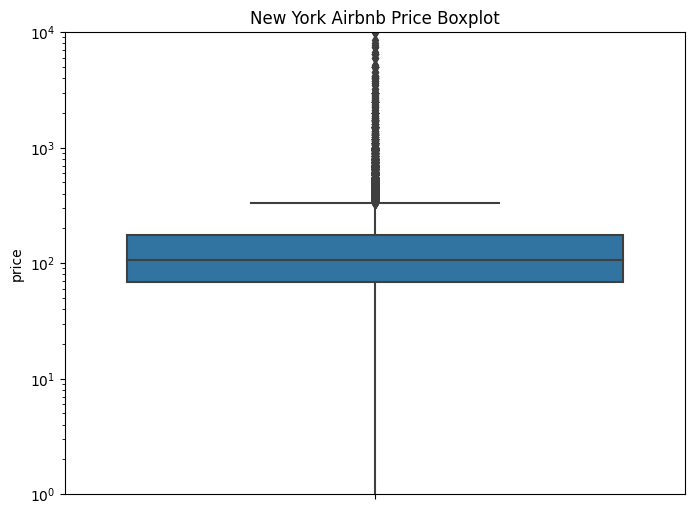

In [8]:
sns.boxplot(data=Airbnb, y="price")
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(8, 6)
plt.title('New York Airbnb Price Boxplot')
#plt.savefig('figures/price_boxplot.png')
plt.show()

- Calculate Extreme Outlier

In [9]:
### Outlier
IQ = Airbnb['price'].describe()["75%"] - Airbnb['price'].describe()["25%"]
### upper outer fence
uof = Airbnb['price'].describe()["75%"] + 3*IQ
### lower outer fence
lof = Airbnb['price'].describe()["25%"] - 3*IQ
print("precentage of extreme outlier in this data:",str((sum(Airbnb['price']>=uof)/len(Airbnb['price']))*100),"%")

precentage of extreme outlier in this data: 2.716024133346968 %


#### Where price is 0

In [10]:
len(Airbnb[Airbnb['price']==min(Airbnb['price'])])

11

Price cannot be 0, we will drop them

In [11]:
Airbnb = Airbnb.loc[Airbnb["price"]!= 0].reset_index(drop=True)

**Comment** 
* According to the statistics, Y is continuous variable
* Strong right skewed
    * we should satrify while spliting the dataset

There is no missing value in target variable.

### Split target and predictor

In [12]:
X = Airbnb.loc[:,Airbnb.columns!="price"]
y = Airbnb["price"]

### 1. id

In [13]:
## check unique
len(X["id"].unique())
print("case id is not unique:",str(sum(X["id"].value_counts()!=1)))
X.drop(['id'], axis=1, inplace=True)

case id is not unique: 0


* categorical variable
* No duplicated values, function as identifier of each observations (airbnb)

### 2. name

In [14]:
## Check the column
print(X["name"].head())
## drop the column
X.drop(['name'], axis=1, inplace=True)

0                  Clean & quiet apt home by the park
1                               Skylit Midtown Castle
2                 THE VILLAGE OF HARLEM....NEW YORK !
3                     Cozy Entire Floor of Brownstone
4    Entire Apt: Spacious Studio/Loft by central park
Name: name, dtype: object


* Text data
* Not important in our senorial
* contain 0.000327 missing value
* We should drop this entire column

### 3. host_id

* Summary Statistics

In [15]:
print(len(X["host_id"].unique()))
value = X["host_id"].value_counts().describe()
Summary = pd.concat([value], axis=1, 
                         keys=['value'], 
                         sort=False)
Summary
## most host only have one list, one host have 327 list

37455


,value
count,37455.00000
mean,1.30514
std,2.76058
min,1.00000
25%,1.00000
50%,1.00000
75%,1.00000
max,327.00000


In [16]:
number_of_airbnb = X["host_id"].value_counts()
list_per_owner = pd.concat([number_of_airbnb], axis=1, 
                         keys=['number_of_airbnb'], 
                         sort=False)

## Number of lists each host owned
list_per_owner

,number_of_airbnb
219517861,327
107434423,232
30283594,121
137358866,103
12243051,96
...,...
1722054,1
33363604,1
69507287,1
20892338,1


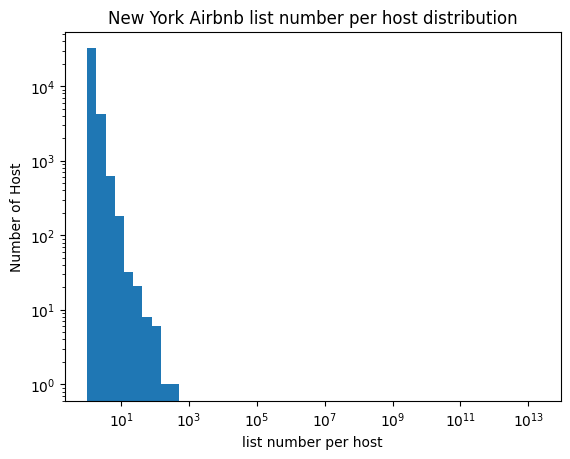

In [17]:
list_per_owner["number_of_airbnb"].plot.hist(log=True, 
                                             bins = np.logspace(np.log2(1),
                                                                np.log2(np.max(Airbnb['price'])),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('list number per host')
plt.ylabel('Number of Host')
plt.title('New York Airbnb list number per host distribution')
#plt.savefig('figures/lists_per_host.png')
plt.show()

In [18]:
X.drop(['host_id'], axis=1, inplace=True)

* Categorical
* The id number of the host.
* There is duplication, one host can have multiple properties.
* There are 37457 host recorded
* The average number of properties managed by host are 1.3
* The minimum number of properties managed by host is 1
* The maximum number of properties managed by host are 327

### 4. host_name

In [19]:
print(X["host_name"].head())
X.drop(['host_name'], axis=1, inplace=True)

0           John
1       Jennifer
2      Elisabeth
3    LisaRoxanne
4          Laura
Name: host_name, dtype: object


* Text dataset
* the name of the host
* Missing proportion is 0.000429
* We can use the host_id as the host identifier
* Not important and drop


### 5. neighbourhood_group

In [20]:
## Unique region
for region in Airbnb['neighbourhood_group'].unique():
    print(region)

Brooklyn
Manhattan
Queens
Staten Island
Bronx


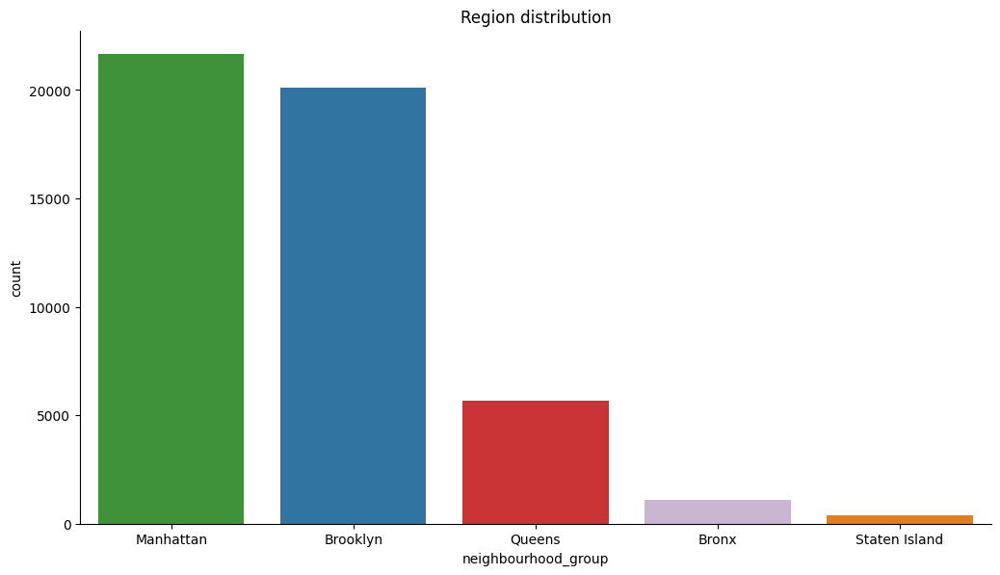

In [21]:
## lists_per_region
custom_palette = sns.color_palette("Paired", 9)
my_pal = {"Brooklyn": custom_palette[1], 
          "Manhattan": custom_palette[3], 
          "Queens":custom_palette[5],
          "Staten Island": custom_palette[7],
          "Bronx": custom_palette[8]}


sns.catplot(x='neighbourhood_group', kind='count' ,data=Airbnb, order = ["Manhattan", "Brooklyn",
                                                                         "Queens", "Bronx", 
                                                                         "Staten Island"], palette=my_pal)
plt.title('Region distribution')
fig = plt.gcf()
fig.set_size_inches(12, 6)
# plt.savefig('figures/lists_per_region.png')
plt.show()

In [22]:
## proportion of manhattan
print(sum(Airbnb["neighbourhood_group"]=="Manhattan")/len(Airbnb["neighbourhood_group"]))
## minimum price in staten Island
print(min(Airbnb[(Airbnb["neighbourhood_group"]== "Staten Island")]["price"]))

0.44308976352180673
13


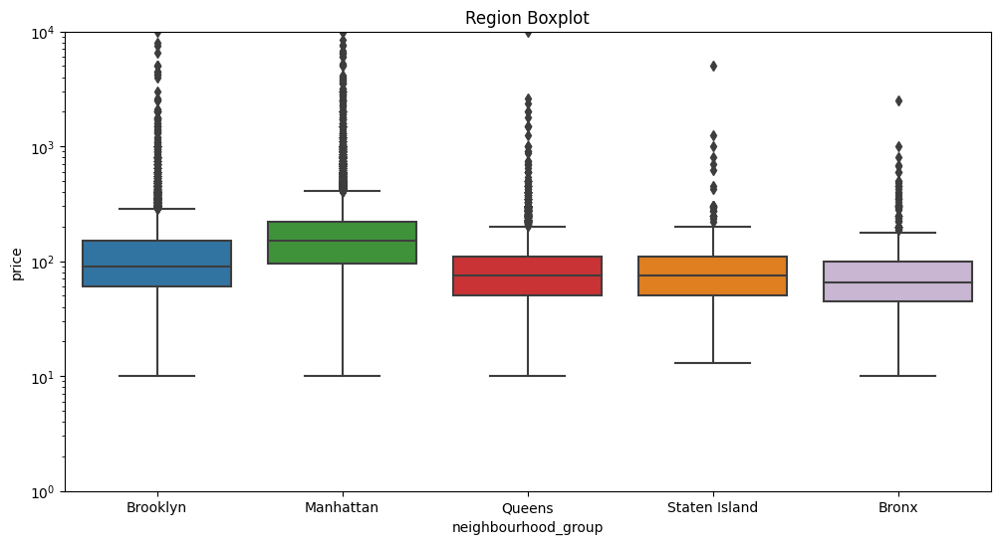

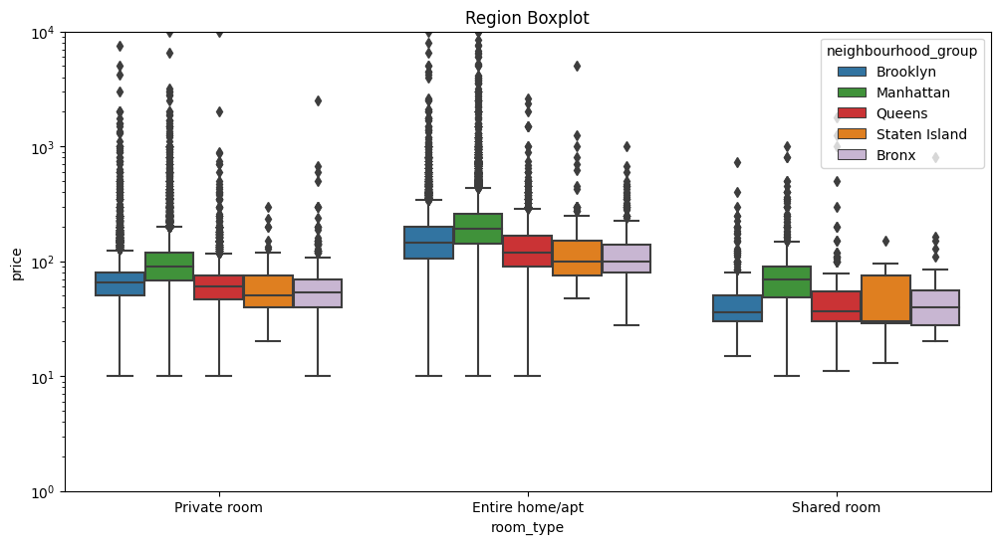

In [23]:
sns.boxplot(data=Airbnb, x="neighbourhood_group", y="price", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
plt.title('Region Boxplot')
#plt.savefig('figures/lists_per_region_boxplot.png')
plt.show()
sns.boxplot(data=Airbnb, x="room_type", y="price", hue = "neighbourhood_group", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
plt.title('Region Boxplot')
#plt.savefig('figures/lists_per_region_boxplot_on_room_type.png')
plt.show()

* Categorical variable
* 5 categories
* Manhattan have the most number of airbnb
* Staten Island have the less number of airbnb
* Check population in each region


### 6. neighbourhood

221
Williamsburg          3919
Bedford-Stuyvesant    3710
Harlem                2658
Bushwick              2462
Upper West Side       1971
Name: neighbourhood, dtype: int64


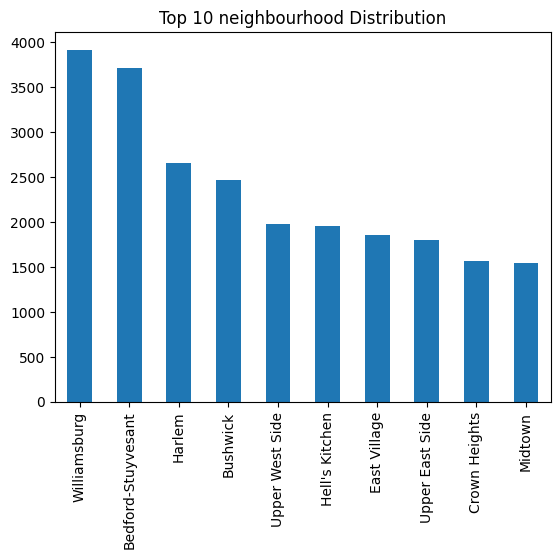

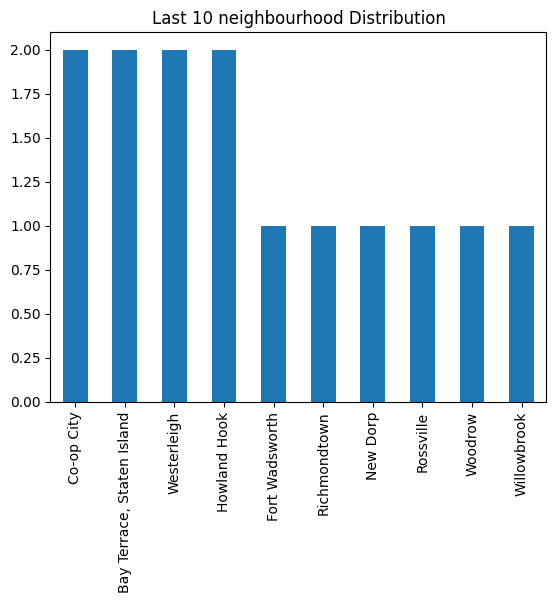

In [24]:
print(X["neighbourhood"].nunique())
print(X["neighbourhood"].value_counts().head())
### Top 10, 221 total
pd.value_counts(X['neighbourhood']).sort_values(ascending = False)[:10].plot.bar()
plt.title('Top 10 neighbourhood Distribution')
#plt.savefig('figures/Top_10_neighbourhood.png')
plt.show()
### Least 10
pd.value_counts(X['neighbourhood']).sort_values(ascending = False)[-10:].plot.bar()
plt.title('Last 10 neighbourhood Distribution')
#plt.savefig('figures/Bottom_10_neighbourhood.png')
plt.show()

* Categorical Variable, name of the naborhood
* 221 categories
* More specify than neighbourhood_group


### 7. latitude and longitude

In [25]:
X[["latitude","longitude"]]

,latitude,longitude
0,40.64749,-73.97237
1,40.75362,-73.98377
2,40.80902,-73.94190
3,40.68514,-73.95976
4,40.79851,-73.94399
...,...,...
48879,40.67853,-73.94995
48880,40.70184,-73.93317
48881,40.81475,-73.94867
48882,40.75751,-73.99112


In [26]:
import plotly
import plotly.express as px
import pandas as pd
#size = "price",
px.set_mapbox_access_token(open("access.mapbox_token").read())
df = Airbnb[Airbnb['price']<=uof]
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color="price",opacity=0.2,
                  color_continuous_scale=px.colors.sequential.Blugrn, size_max=15, 
                        height=900, zoom=10, title = "New York City Airbnb Price")
fig.show()


In [27]:
import plotly
import plotly.express as px
import pandas as pd
#size = "price",
px.set_mapbox_access_token(open("access.mapbox_token").read())
df = Airbnb
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color="neighbourhood_group", opacity=1,
                  color_continuous_scale=px.colors.sequential.Blugrn, size_max=15, height=900, zoom=10)
fig.show()

In [28]:
import plotly
import plotly.express as px
import pandas as pd
#size = "price",
px.set_mapbox_access_token(open("access.mapbox_token").read())
df = Airbnb
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color="neighbourhood", opacity=0.2,
                  color_continuous_scale=px.colors.sequential.Blugrn, size_max=15, height=900, zoom=10)
fig.show()

In [29]:
#reviews_per_month
import plotly
import plotly.express as px
import pandas as pd
#size = "price",
px.set_mapbox_access_token(open("access.mapbox_token").read())
df = Airbnb
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color="reviews_per_month",opacity=0.5,
                  color_continuous_scale=px.colors.sequential.Blugrn, size_max=15, height=900, zoom=10)
fig.show()

In [30]:
# number_of_reviews
px.set_mapbox_access_token(open("access.mapbox_token").read())
df = Airbnb
fig = px.scatter_mapbox(df, lat="latitude", lon="longitude", color="number_of_reviews",opacity=0.5,
                  color_continuous_scale=px.colors.sequential.Blugrn, size_max=15, height=900, zoom=10)
fig.show()

   ### 8. room_type

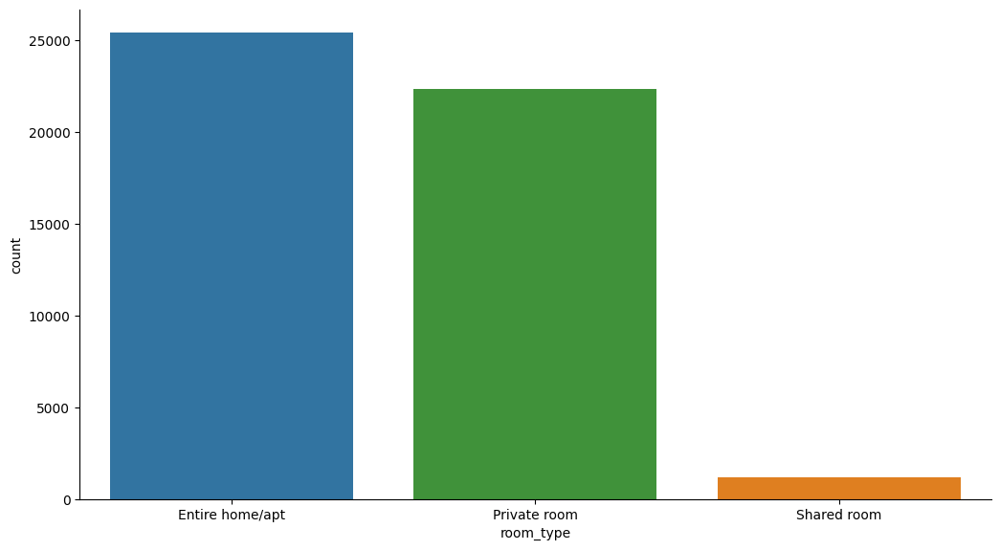

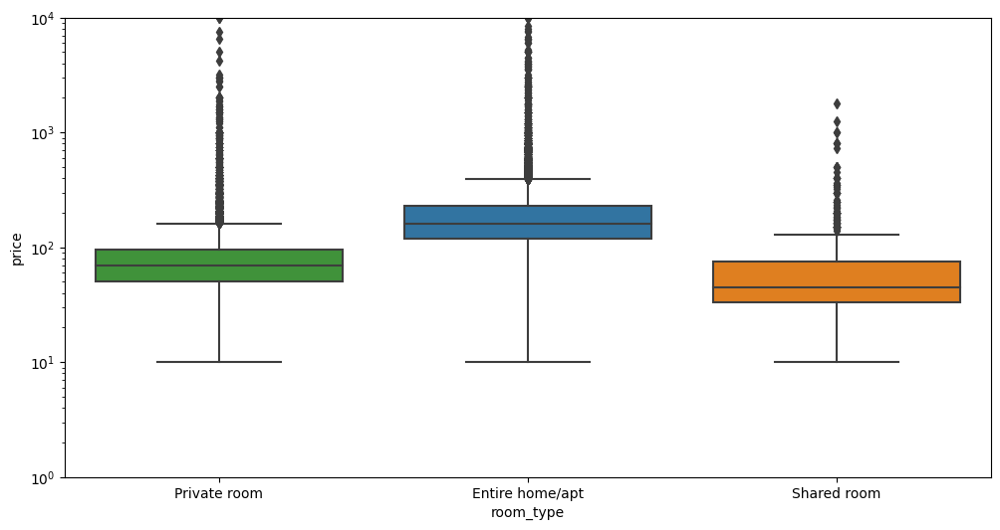

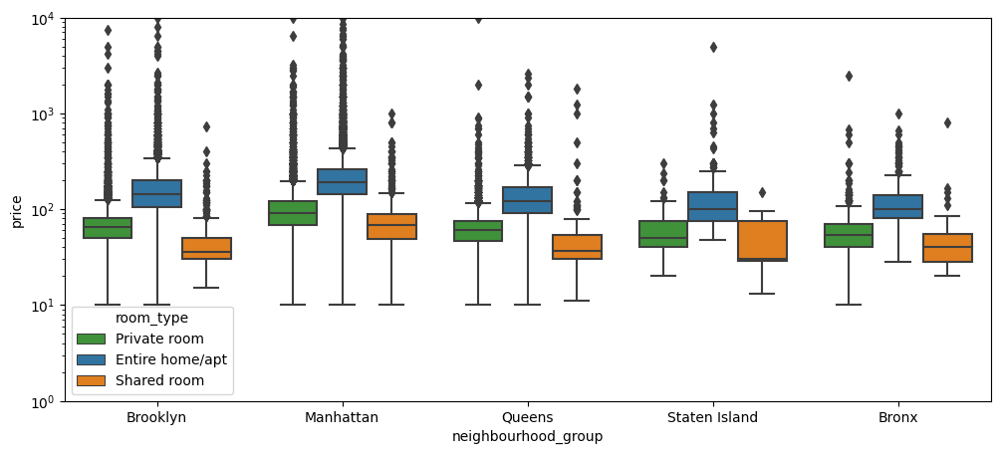

In [31]:
custom_palette = sns.color_palette("Paired", 9)
my_pal = {"Entire home/apt": custom_palette[1], "Private room": custom_palette[3], 
          "Shared room":custom_palette[7]}
sns.catplot(x='room_type', kind='count' ,data=Airbnb, order = ["Entire home/apt", 
                                                               'Private room', 'Shared room'], palette=my_pal)
fig = plt.gcf()
fig.set_size_inches(12, 6)
#plt.savefig('figures/room_type.png')
plt.show()
sns.boxplot(data=Airbnb, x="room_type", y="price", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
#plt.savefig('figures/room_type_and _price_boxplot.png')
plt.show()
sns.boxplot(data=Airbnb, x="neighbourhood_group", y="price", hue = "room_type", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 5)
#plt.savefig('figures/room_type_and _price_on_region_boxplot.png')
plt.show()

   ### 9. minimum_nights

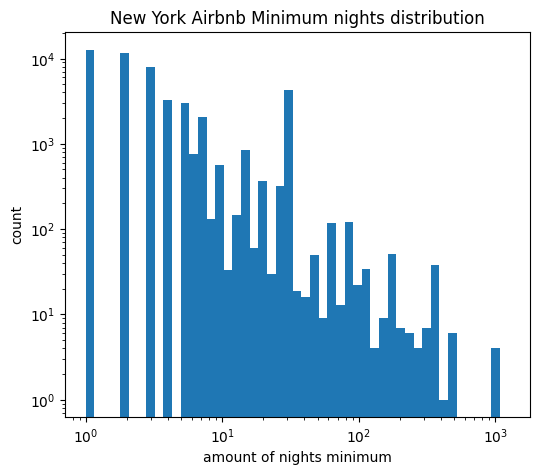

In [32]:
plt.figure(figsize = (6,5))
X["minimum_nights"].plot.hist(log=True, bins = np.logspace(np.log10(1),np.log10(np.max(X["minimum_nights"])),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('amount of nights minimum')
plt.ylabel('count')
plt.title('New York Airbnb Minimum nights distribution')
#plt.savefig('figures/minimum_nights.png')
plt.show()

In [33]:
value = X["minimum_nights"].describe()
Summary = pd.concat([value], axis=1, 
                         keys=['value'], 
                         sort=False)
Summary

,value
count,48884.000000
mean,7.029887
std,20.512224
min,1.000000
25%,1.000000
50%,3.000000
75%,5.000000
max,1250.000000


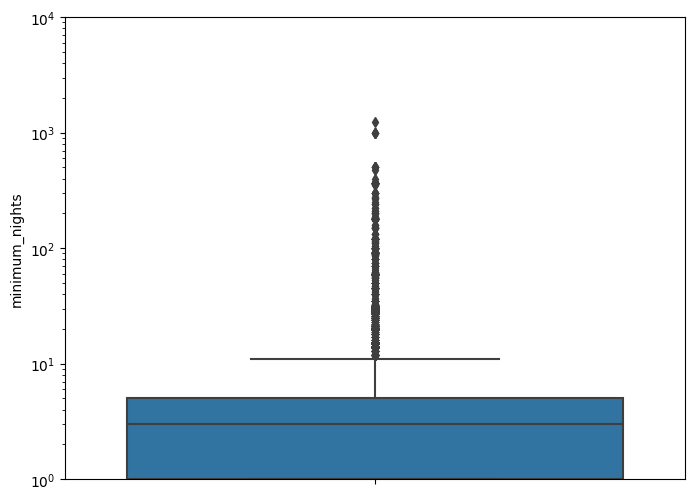

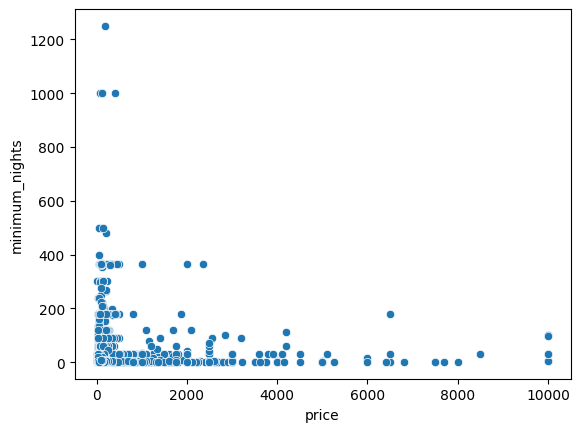

In [34]:
sns.boxplot(data=Airbnb, y="minimum_nights")
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(8, 6)
#plt.savefig('figures/minimum_nights_boxplot.png')
plt.show()
sns.scatterplot(data=Airbnb, x="price", y="minimum_nights")
#plt.savefig('figures/minimum_nights_and_price.png')
plt.show()

* Maximum mini night 1250 three and a half years.
* Average mini night is 7 
* Median mini night is 3


### 10. number_of_reviews

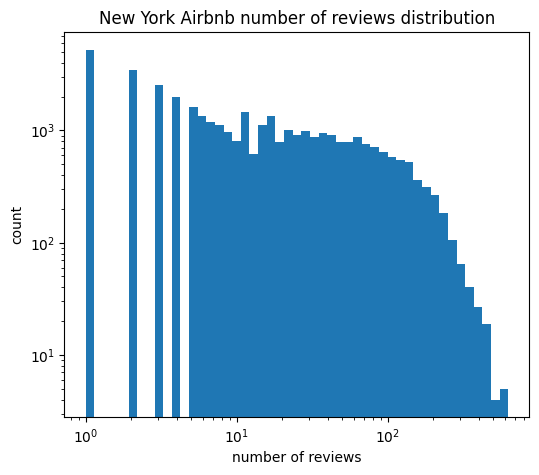

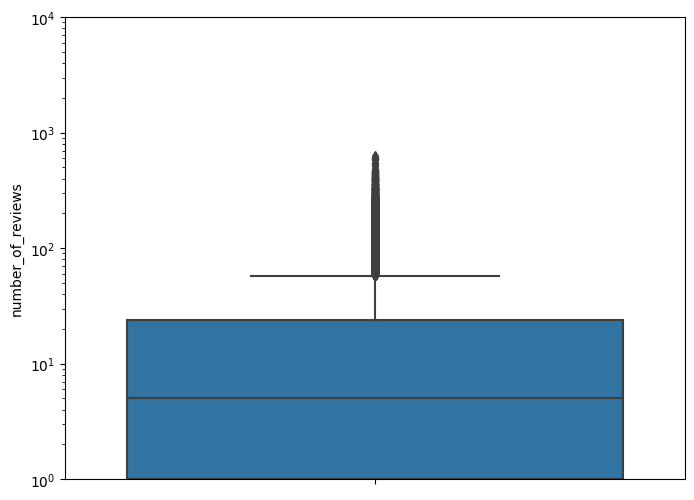

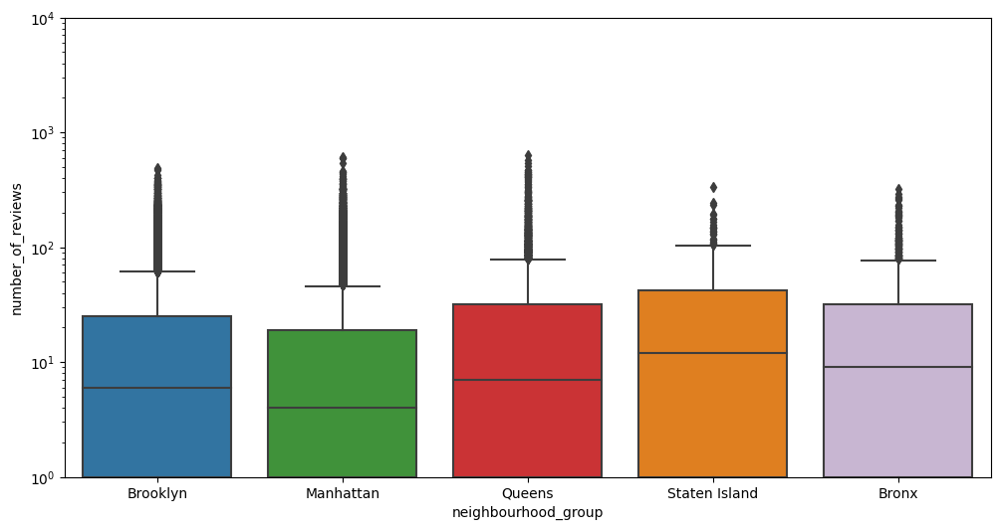

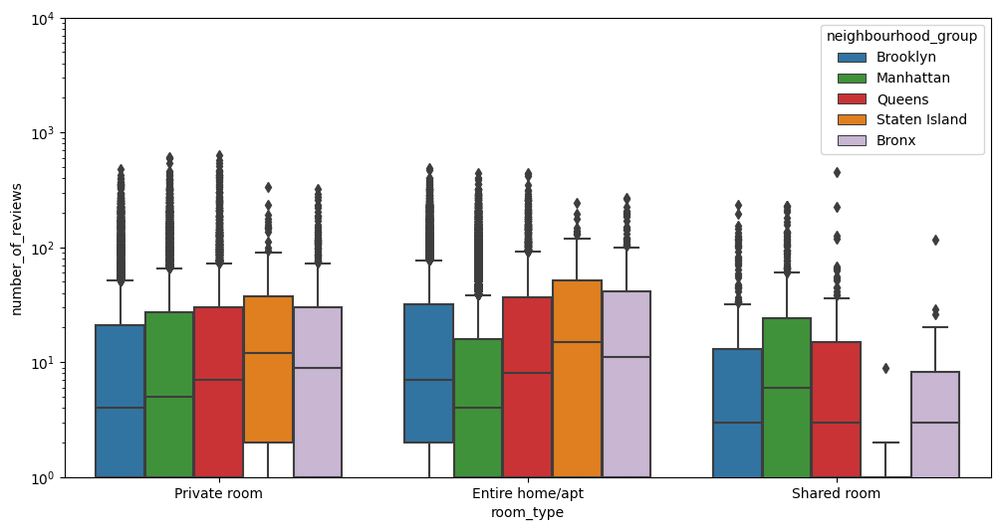

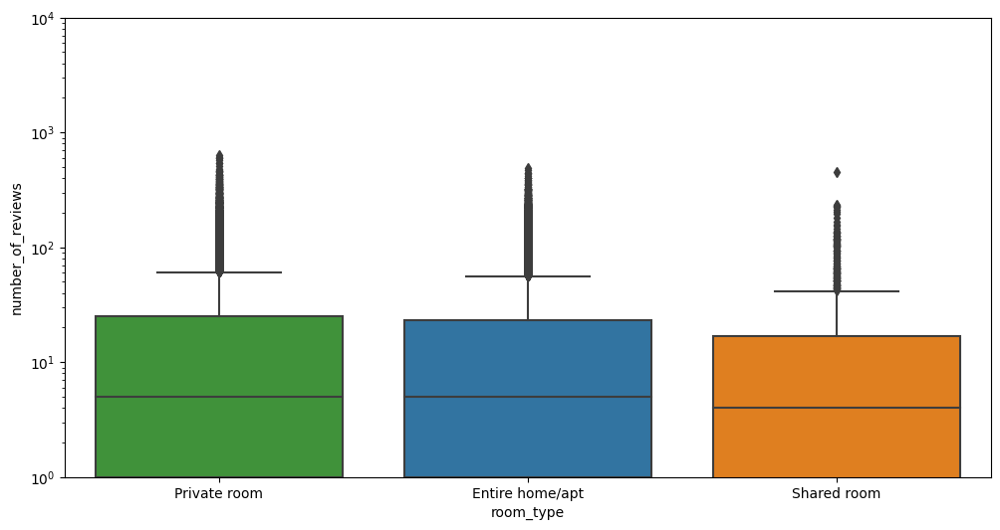

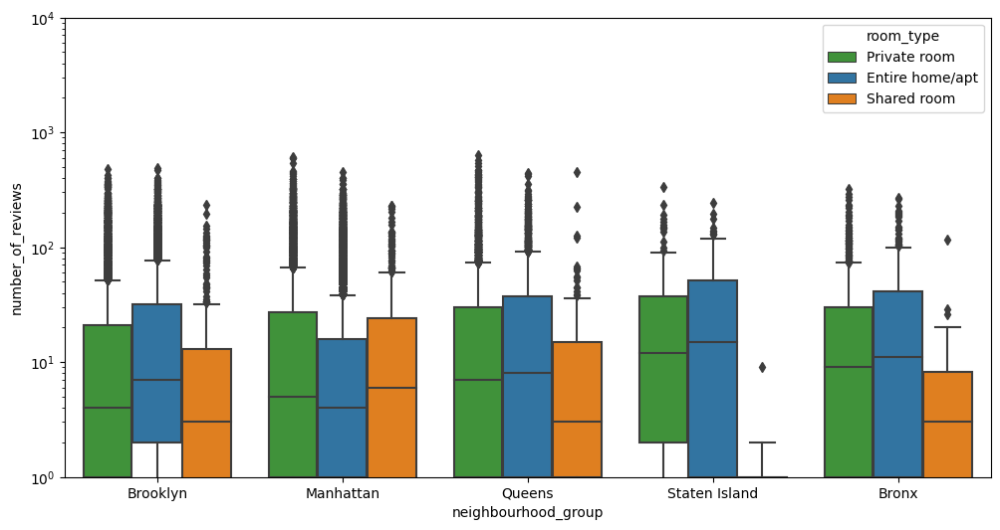

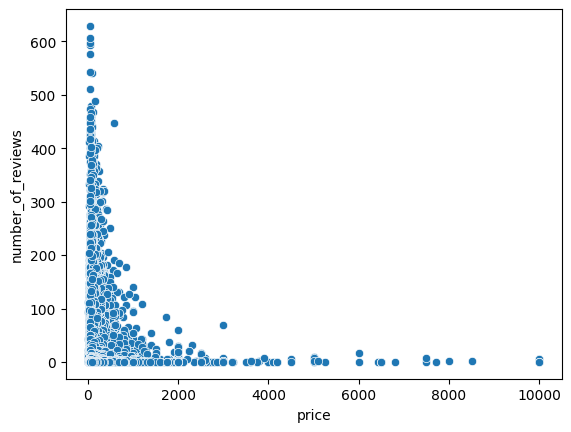

In [35]:
plt.figure(figsize = (6,5))
X["number_of_reviews"].plot.hist(log=True, bins = np.logspace(np.log10(1),np.log10(np.max(X["number_of_reviews"])),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('number of reviews')
plt.ylabel('count')
plt.title('New York Airbnb number of reviews distribution')
#plt.savefig('figures/reviews.png')
plt.show()

sns.boxplot(data=Airbnb, y="number_of_reviews")
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(8, 6)
#plt.savefig('figures/reviews_boxplot.png')
plt.show()

custom_palette = sns.color_palette("Paired", 9)
my_pal = {"Brooklyn": custom_palette[1], 
          "Manhattan": custom_palette[3], 
          "Queens":custom_palette[5],
          "Staten Island": custom_palette[7],
          "Bronx": custom_palette[8]}


sns.boxplot(data=Airbnb, x="neighbourhood_group", y="number_of_reviews", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
#plt.savefig('figures/reviews_on_region_boxplot.png')
plt.show()

sns.boxplot(data=Airbnb, x="room_type", y="number_of_reviews", hue = "neighbourhood_group", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
#plt.savefig('figures/reviews_on_room_typeand_region_boxplot.png')
plt.show()

my_pal = {"Entire home/apt": custom_palette[1], "Private room": custom_palette[3], "Shared room":custom_palette[7]}
sns.boxplot(data=Airbnb, x="room_type", y="number_of_reviews", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
#plt.savefig('figures/reviews_on_room_type_boxplot.png')
plt.show()

sns.boxplot(data=Airbnb, x="neighbourhood_group", y="number_of_reviews", hue = "room_type", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
#plt.savefig('figures/reviews_on_region_and_room_boxplot.png')
plt.show()

sns.scatterplot(data=Airbnb, x="price", y="number_of_reviews")
#plt.savefig('figures/reviews_and_price.png')
plt.show()

* The average number of review is 23
* Median is 5
* min is 0
* max is 629


### 11. last_review

In [36]:
X["last_review"].value_counts()

2019-06-23    1412
2019-07-01    1359
2019-06-30    1341
2019-06-24     874
2019-07-07     718
              ... 
2015-02-28       1
2014-08-01       1
2012-08-25       1
2013-12-25       1
2018-03-29       1
Name: last_review, Length: 1764, dtype: int64

   ### 12. New variable

In [37]:
X["gap_between_last_review_and_end_of_2019"] = [i.days for i in pd.to_datetime("2019-12-31", infer_datetime_format=True) - X["last_review"]]
Airbnb["gap_between_last_review_and_end_of_2019"] = X["gap_between_last_review_and_end_of_2019"]

value = X["gap_between_last_review_and_end_of_2019"].describe()
Summary = pd.concat([value], axis=1, 
                         keys=['value'], 
                         sort=False)
Summary

,value
count,38833.000000
mean,452.947802
std,413.948228
min,176.000000
25%,191.000000
50%,226.000000
75%,541.000000
max,3200.000000


In [38]:
X.drop(['last_review'], axis=1, inplace=True)

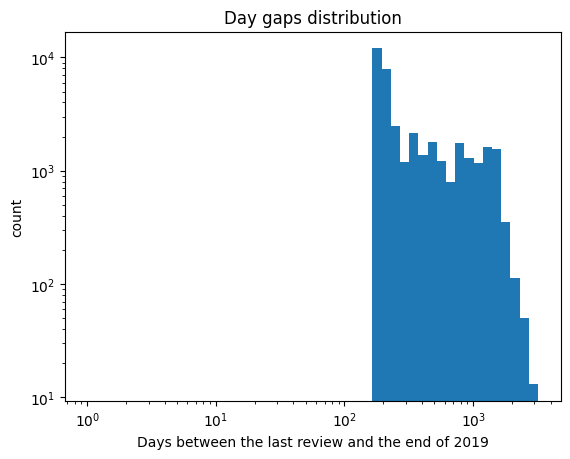

In [39]:
X["gap_between_last_review_and_end_of_2019"].plot.hist(log=True, bins = np.logspace(np.log10(1),np.log10(np.max(X["gap_between_last_review_and_end_of_2019"])),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('Days between the last review and the end of 2019')
plt.ylabel('count')
plt.title('Day gaps distribution')
#plt.savefig('figures/Gap_day.png')
plt.show()

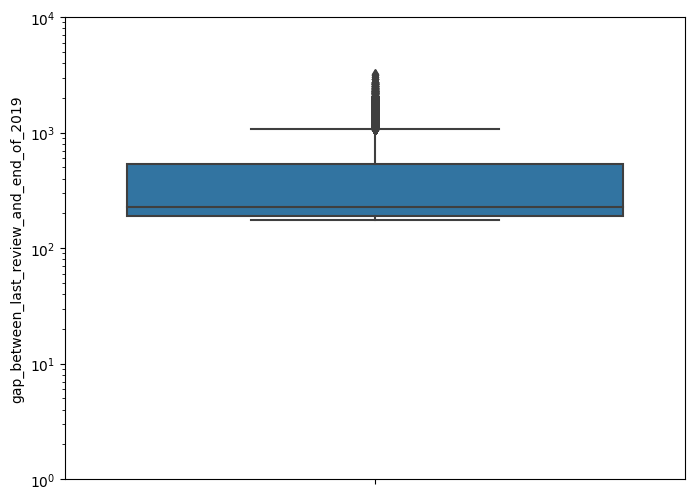

In [40]:
sns.boxplot(data=X, y="gap_between_last_review_and_end_of_2019")
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(8, 6)
#plt.savefig('figures/gap_day_boxplot.png')
plt.show()

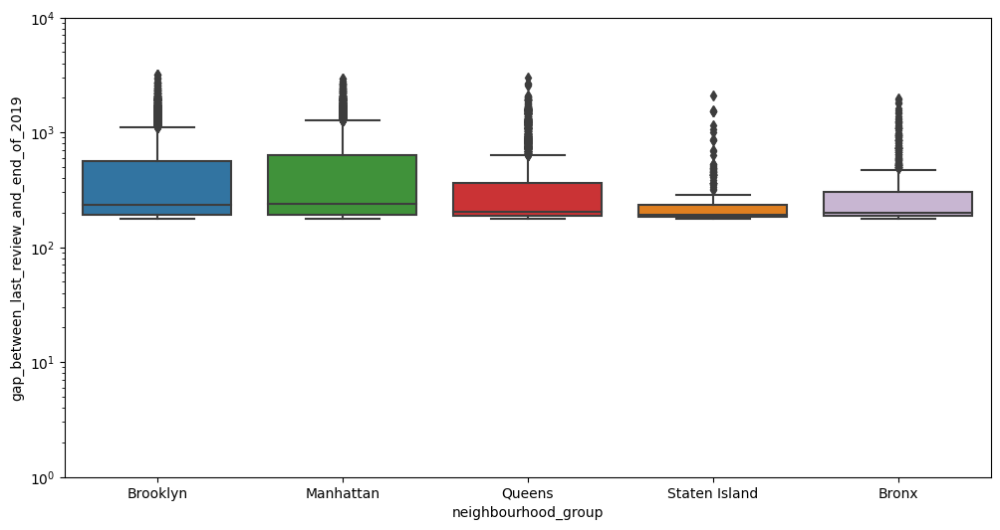

In [41]:
custom_palette = sns.color_palette("Paired", 9)
my_pal = {"Brooklyn": custom_palette[1], 
          "Manhattan": custom_palette[3], 
          "Queens":custom_palette[5],
          "Staten Island": custom_palette[7],
          "Bronx": custom_palette[8]}


sns.boxplot(data=Airbnb, x="neighbourhood_group", y="gap_between_last_review_and_end_of_2019", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
#plt.savefig('figures/ap_day_on_region_boxplot.png')
plt.show()

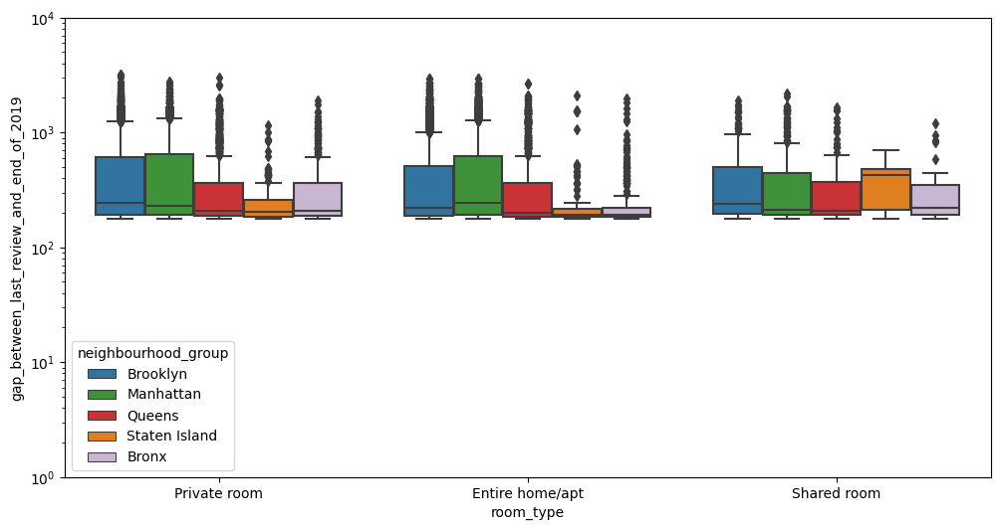

In [42]:
sns.boxplot(data=Airbnb, x="room_type", y="gap_between_last_review_and_end_of_2019", 
            hue = "neighbourhood_group", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
#plt.savefig('figures/ap_day_on_region_and_room_type_boxplot.png')
plt.show()

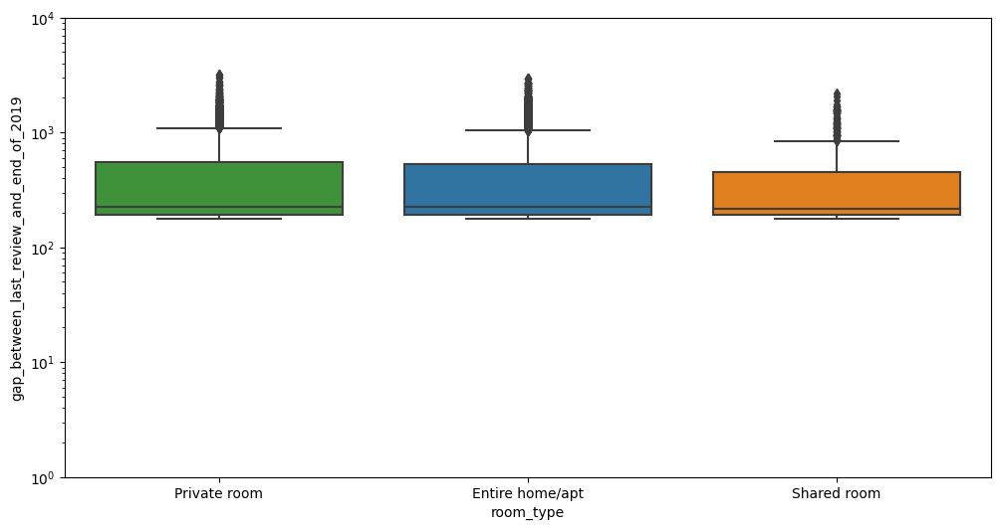

In [43]:
my_pal = {"Entire home/apt": custom_palette[1], "Private room": custom_palette[3], 
          "Shared room":custom_palette[7]}
sns.boxplot(data=Airbnb, x="room_type", y="gap_between_last_review_and_end_of_2019", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)
#plt.savefig('figures/Gap_day_on_room_type_boxplot.png')
plt.show()

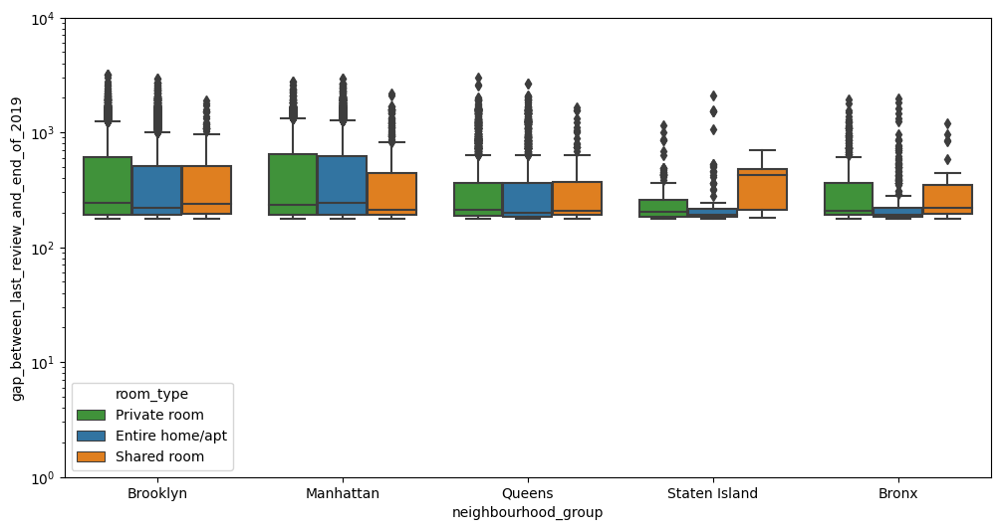

In [44]:
sns.boxplot(data=Airbnb, x="neighbourhood_group", y="gap_between_last_review_and_end_of_2019", hue = "room_type", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)

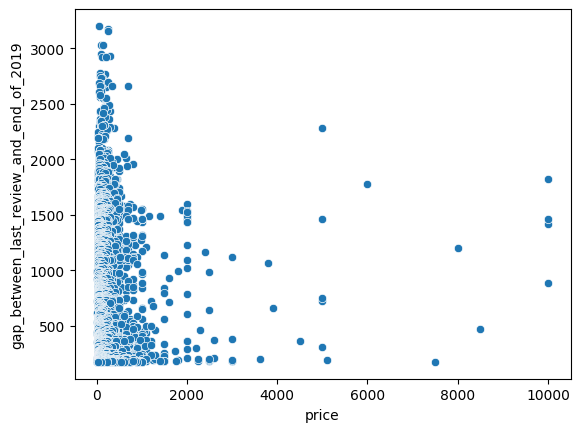

In [45]:
sns.scatterplot(data=Airbnb, x="price", y="gap_between_last_review_and_end_of_2019")
#plt.savefig('figures/price_and_gap.png')
plt.show()

* Not important
* drop

   ### 13. reviews_per_month

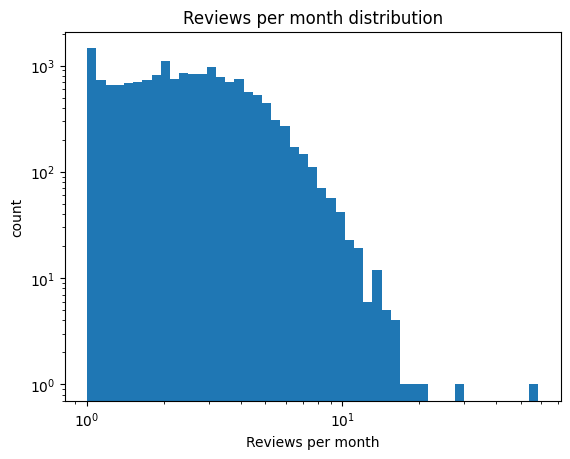

In [46]:
X["reviews_per_month"].plot.hist(log=True, bins = np.logspace(np.log10(1),np.log10(np.max(X["reviews_per_month"])),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('Reviews per month')
plt.ylabel('count')
plt.title('Reviews per month distribution')
plt.savefig('figures/review_rate.png')
plt.show()


In [47]:
value = X["reviews_per_month"].describe()
Summary = pd.concat([value], axis=1, 
                         keys=['value'], 
                         sort=False)
Summary

,value
count,38833.000000
mean,1.373128
std,1.680391
min,0.010000
25%,0.190000
50%,0.720000
75%,2.020000
max,58.500000


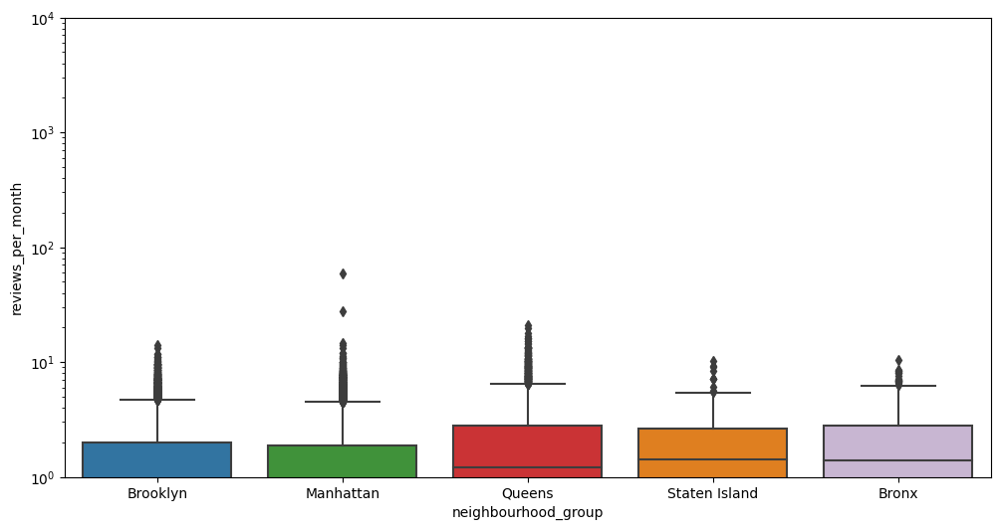

In [48]:
custom_palette = sns.color_palette("Paired", 9)
my_pal = {"Brooklyn": custom_palette[1], 
          "Manhattan": custom_palette[3], 
          "Queens":custom_palette[5],
          "Staten Island": custom_palette[7],
          "Bronx": custom_palette[8]}


sns.boxplot(data=Airbnb, x="neighbourhood_group", y="reviews_per_month", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)

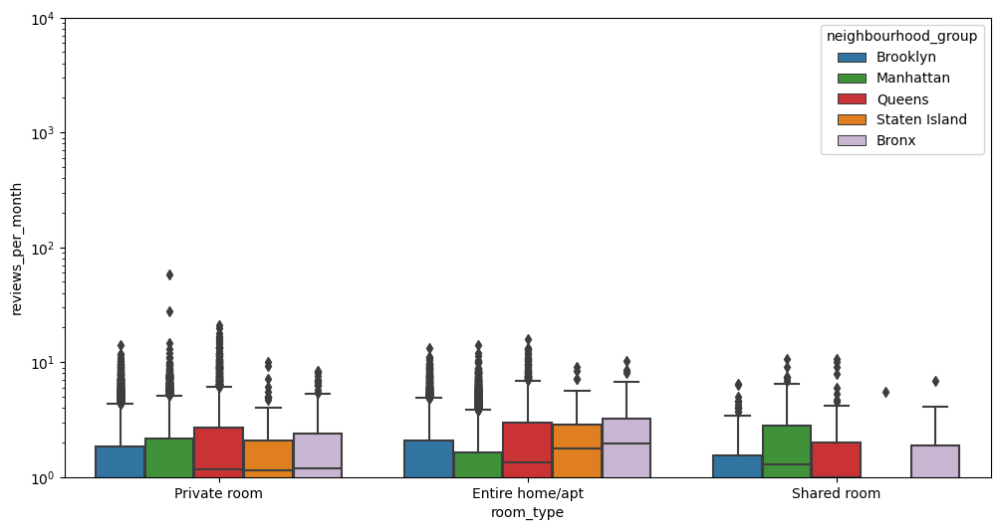

In [49]:
sns.boxplot(data=Airbnb, x="room_type", y="reviews_per_month", hue = "neighbourhood_group", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)

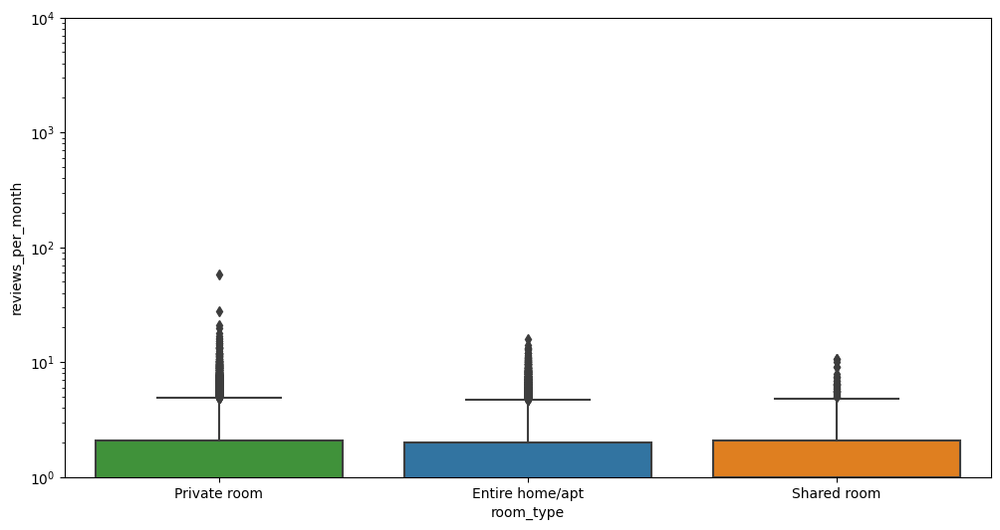

In [50]:
my_pal = {"Entire home/apt": custom_palette[1], "Private room": custom_palette[3], "Shared room":custom_palette[7]}
sns.boxplot(data=Airbnb, x="room_type", y="reviews_per_month", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)

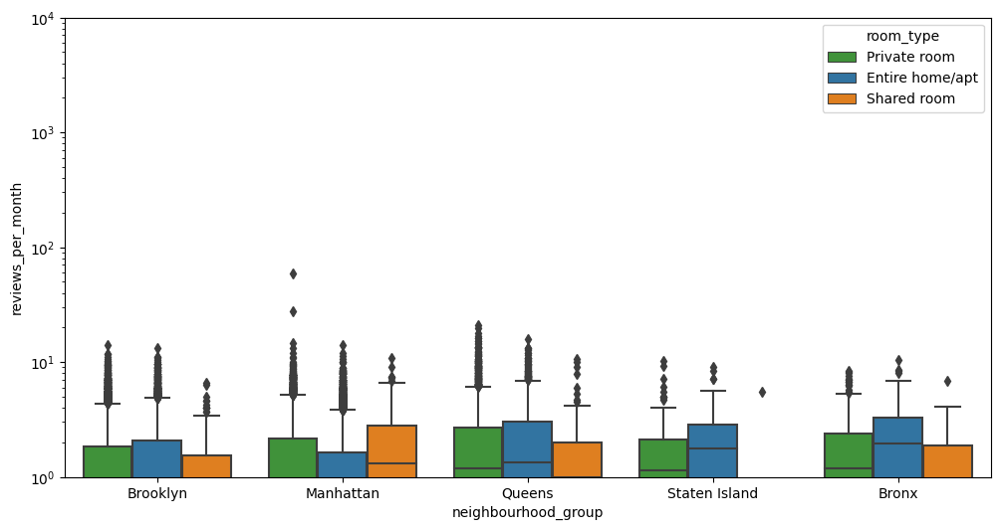

In [51]:
sns.boxplot(data=Airbnb, x="neighbourhood_group", y="reviews_per_month", hue = "room_type", palette=my_pal)
plt.yscale('log')
plt.ylim(1,10000)
fig = plt.gcf()
fig.set_size_inches(12, 6)

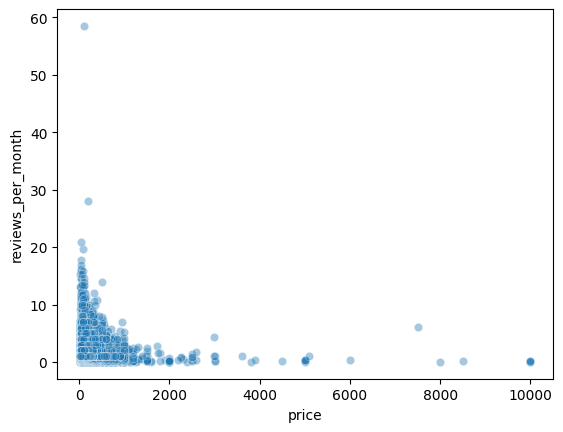

In [52]:
sns.scatterplot(data=Airbnb, x="price", y="reviews_per_month", alpha = 0.4)
plt.savefig('figures/review_rate_price.png')
plt.show()

### 14. calculated_host_listings_count

In [53]:
value = X["calculated_host_listings_count"].describe()
Summary = pd.concat([value], axis=1, 
                         keys=['value'], 
                         sort=False)
Summary


,value
count,48884.000000
mean,7.144628
std,32.956185
min,1.000000
25%,1.000000
50%,1.000000
75%,2.000000
max,327.000000


In [54]:
sum(X["calculated_host_listings_count"]>1)/len(X["calculated_host_listings_count"])

0.33923165043777104

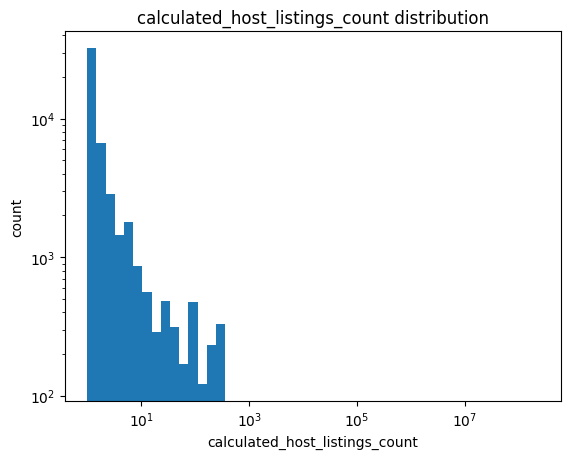

In [55]:
X["calculated_host_listings_count"].plot.hist(log=True, bins = np.logspace(np.log2(1),np.log2(np.max(X["calculated_host_listings_count"])),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('calculated_host_listings_count')
plt.ylabel('count')
plt.title('calculated_host_listings_count distribution')
plt.show()

* The number of total properties the host have

   ### 15. availability_365

<AxesSubplot:>

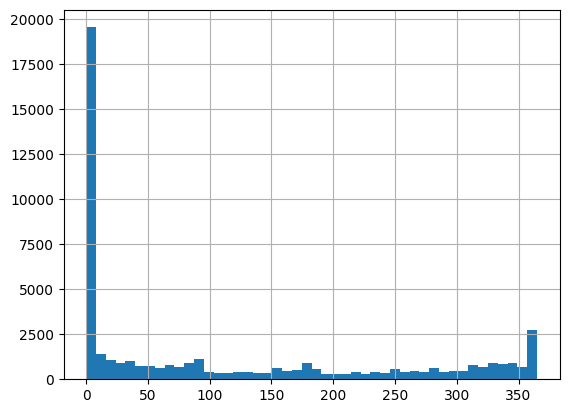

In [56]:
X["availability_365"].hist(bins = X["availability_365"].nunique()-320)

In [57]:
X["availability_365"].describe()

count    48884.000000
mean       112.779498
std        131.627271
min          0.000000
25%          0.000000
50%         45.000000
75%        227.000000
max        365.000000
Name: availability_365, dtype: float64

<AxesSubplot:xlabel='price', ylabel='availability_365'>

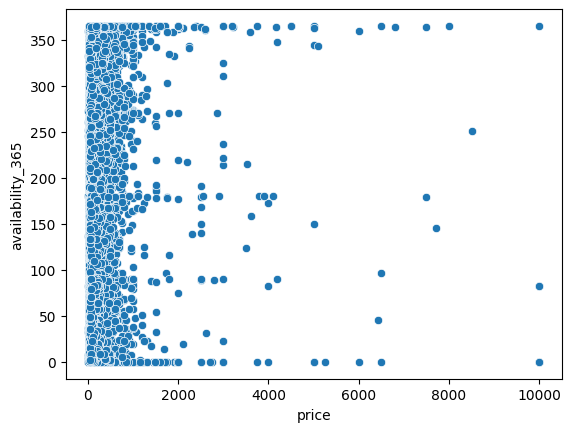

In [58]:
sns.scatterplot(data=Airbnb, x="price", y="availability_365")

## Save data

In [59]:
EDA_data = X
EDA_data["price"] = y
#EDA_data.to_csv(r'../Data/EDA_data.csv',index=False)

In [66]:
EDA_data.shape

(48884, 12)

# Spliting
---

### Stratified Based Spliting

In [60]:
## Basic Split
X_train, X_other, y_train, y_other = scsplit(X, 
                                             y, 
                                             stratify = y, 
                                             train_size = 0.7, 
                                             random_state = 130)

X_val, X_test, y_val, y_test = scsplit(X_other.reset_index(drop=True), 
                                       y_other.reset_index(drop=True), 
                                       stratify = y_other.reset_index(drop=True), 
                                       train_size = 0.7, 
                                       random_state = 130)
print("sum of sets:",str(len(y_train)/len(Airbnb)+len(y_val)/len(Airbnb)+len(y_test)/len(Airbnb)))
print("Train Set:",str(len(y_train)/len(Airbnb)))
print("Validation Set:", str(len(y_val)/len(Airbnb)))
print("Test Set:", str(len(y_test)/len(Airbnb)))

sum of sets: 1.0
Train Set: 0.6999836347271091
Validation Set: 0.2100073643728009
Test Set: 0.09000900090009001


### Stratified Kfold Spliting

In [61]:
### K fold
#X_other, X_fold1, y_other, y_fold1 = scsplit(X, 
#                                             y, 
#                                             stratify = y, 
#                                             train_size = 0.8, 
#                                             random_state = 130)
#
#X_other, X_fold2, y_other, y_fold2 = scsplit(X_other.reset_index(drop=True), 
#                                       y_other.reset_index(drop=True), 
#                                       stratify = y_other.reset_index(drop=True), 
#                                       train_size = 0.7, 
#                                       random_state = 130)
#X_other, X_fold3, y_other, y_fold3 = scsplit(X_other.reset_index(drop=True), 
#                                       y_other.reset_index(drop=True), 
#                                       stratify = y_other.reset_index(drop=True), 
#                                       train_size = 0.7, 
#                                       random_state = 130)
#X_fold5, X_fold4, y_fold5, y_fold4 = scsplit(X_other.reset_index(drop=True), 
#                                       y_other.reset_index(drop=True), 
#                                       stratify = y_other.reset_index(drop=True), 
#                                       train_size = 0.7, 
#                                       random_state = 130)
#

### Train set

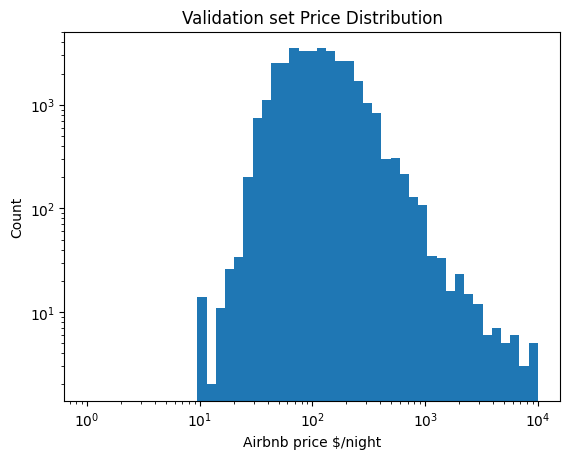

In [62]:
y_train.plot.hist(log=True, bins = np.logspace(np.log10(1),np.log10(np.max(y_train)),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('Airbnb price $/night')
plt.ylabel('Count')
plt.title('Validation set Price Distribution')
plt.show()

### Validation Set

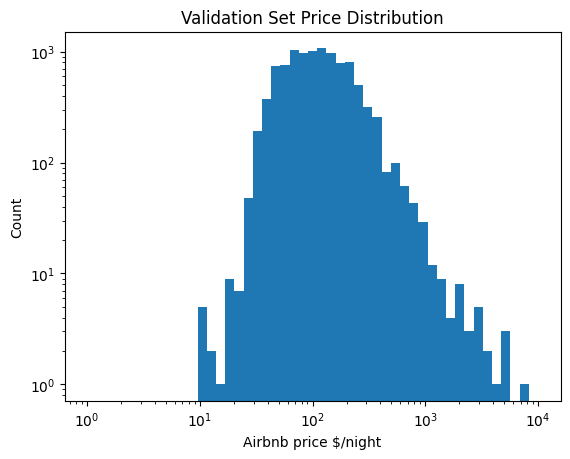

In [63]:
y_val.plot.hist(log=True, bins = np.logspace(np.log10(1),np.log10(np.max(y_val)),50))
plt.semilogy()
plt.semilogx()
plt.xlabel('Airbnb price $/night')
plt.ylabel('Count')
plt.title('Validation Set Price Distribution')
plt.show()

### Test Set

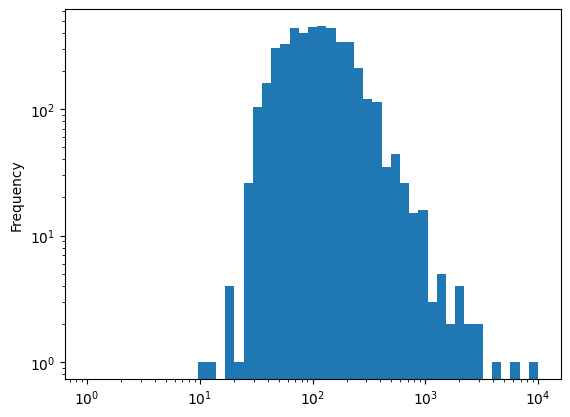

In [64]:
y_test.plot.hist(log=True, bins = np.logspace(np.log10(1),np.log10(np.max(y_test)),50))
plt.semilogy()
plt.semilogx()
#plt.xlabel('Airbnb price $/night')
#plt.ylabel('Count')
#plt.title('Training Set Price Distribution')
plt.show()

## Preprocessing
---

### Check Type

In [67]:
X.dtypes

neighbourhood_group                         object
neighbourhood                               object
latitude                                   float64
longitude                                  float64
room_type                                   object
minimum_nights                               int64
number_of_reviews                            int64
reviews_per_month                          float64
calculated_host_listings_count               int64
availability_365                             int64
gap_between_last_review_and_end_of_2019    float64
price                                        int64
dtype: object

### Define Preprocessor

In [68]:
ordinal_ftrs= ["room_type"]
ordinal_cats = [["Shared room", "Private room", "Entire home/apt"]]
onehot_ftrs = ["neighbourhood_group", "neighbourhood"]
minmax_ftrs = ["availability_365"]
std_ftrs = ["minimum_nights", "number_of_reviews", "longitude", "latitude", "gap_between_last_review_and_end_of_2019","reviews_per_month", "calculated_host_listings_count"]

### Preprocess

In [69]:
# collect all the encoders
preprocessor = ColumnTransformer(
    transformers=[
        ('ord', OrdinalEncoder(categories = ordinal_cats), ordinal_ftrs),
        ('onehot', OneHotEncoder(sparse=False,handle_unknown='ignore'), onehot_ftrs),
        ('minmax', MinMaxScaler(), minmax_ftrs),
        ('std', StandardScaler(), std_ftrs)])

clf = Pipeline(steps=[('preprocessor', preprocessor)]) # for now we only preprocess 
                                                       # later on we will add other steps here

X_train_prep = clf.fit_transform(X_train)
X_val_prep = clf.transform(X_val)
X_test_prep = clf.transform(X_test)

### Check Shape

In [70]:
X_train_prep.shape

(34218, 234)

In [71]:
Airbnb.shape

(48884, 17)

In [72]:
48895-11

48884